# Setup

To run this notebook on Colab, a few setup steps are required. Follow along step by step:

1. **Check your Colab region**  
   First, determine the region where your Colab instance is running. For best performance (faster data transfers), we recommend using a runtime located in the **US** or **Europe**.  
   - If your runtime is elsewhere, stop it and create a new one until it’s in one of the preferred regions.

In [ ]:
!pip install ipinfo==5.1.1 > /dev/null 2>&1
import ipinfo; info = ipinfo.getHandler().getDetails(); print(f"{info.city} ({info.country_name})")

2. **Clone the `dlfb` library**  
   Next, clone the repository that contains the `dlfb` library.

In [ ]:
%cd /content
!rm -rf ./dlfb-clone/
!git clone "https://github.com/deep-learning-for-biology/dlfb.git" dlfb-clone --branch main
%cd dlfb-clone

3. **Install dependencies**  
   Once the library is cloned, install the required dependencies.

In [ ]:
%%bash
curl -LsSf https://astral.sh/uv/install.sh | sh && \
export PATH="/root/.local/bin:${PATH}" && \
uv pip compile ./requirements/{base,dlfb,cancer,gpu}.txt \
  --color never \
  --constraint ./requirements/constraints.txt | \
uv pip install -r - --system

4. **Authenticate with Google**  
   You’ll then need to authenticate with your Google account so the notebook can access and download the necessary datasets for this chapter.

In [ ]:
from google.colab import auth

auth.authenticate_user()
# NOTE: exclude models with '--no-models' flag
!dlfb-provision --chapter cancer

5. **Load the `dlfb` package**  
   Finally, load the `dlfb` package.  
   - ⚠️ Note: Loading can sometimes be finicky. If you encounter issues, simply **restart the runtime**. All previously downloaded data and installed packages will persist, so you can re-run the load step without repeating everything.

In [ ]:
# Toggle JAX_DISABLE_JIT to True for easier debugging
%env JAX_DISABLE_JIT=False

try:
  import dlfb
except ImportError as exc:
  # NOTE: Packages installed in editable mode are not immediately
  #       recognized by Colab (https://stackoverflow.com/a/63312333).
  import site
  site.main()
  import dlfb

import random
import numpy as np
from dlfb.utils.display import display

seed = 42
random.seed(seed)
np.random.seed(seed)

# 5. Detecting Skin Cancer in Medical Images


## 5.1. Biology Primer
### 5.1.1. Skin Cancer
### 5.1.2. Causes and Risk Factors
### 5.1.3. How Skin Cancer Is Diagnosed
### 5.1.4. Image-Based Skin Cancer Detection


## 5.2. Machine Learning Primer
### 5.2.1. Convolutional Neural Networks
### 5.2.2. Understanding a Convolution
### 5.2.3. Understanding Dimensions
### 5.2.4. Pooling
### 5.2.5. Other Components of a CNN
### 5.2.6. ResNets


## 5.3. Exploring the Data
### 5.3.1. A First Glimpse


In [3]:
import re
from pathlib import Path

from dlfb.utils.context import assets

image_file = next(Path(assets("cancer/datasets/raw")).rglob("*.jpg"))

print(rf"One of the images: {re.sub('^.*?datasets/', '', str(image_file))}")

One of the images: raw/Test/melanoma/ISIC_0000031.jpg


In [4]:
import pandas as pd


def load_metadata(data_dir: str) -> pd.DataFrame:
  metadata = []
  for path in Path(data_dir).rglob("*.jpg"):
    split, class_name, _ = path.parts[-3:]
    metadata.append(
      {
        "split_orig": split,
        "class_orig": class_name,
        "full_path": str(path),
      }
    )
  return pd.DataFrame(metadata).rename_axis("frame_id").reset_index()


metadata = load_metadata(assets("cancer/datasets/raw"))
print(metadata)

      frame_id split_orig      class_orig            full_path
0            0       Test        melanoma  /content/drive/M...
1            1       Test        melanoma  /content/drive/M...
2            2       Test        melanoma  /content/drive/M...
...        ...        ...             ...                  ...
2354      2354      Train  dermatofibroma  /content/drive/M...
2355      2355      Train  dermatofibroma  /content/drive/M...
2356      2356      Train  dermatofibroma  /content/drive/M...

[2357 rows x 4 columns]


In [6]:
counts = pd.crosstab(
  metadata["class_orig"], metadata["split_orig"], margins=True
)
print(counts)

split_orig            Test  Train   All
class_orig                             
actinic keratosis       16    114   130
basal cell carcinoma    16    376   392
dermatofibroma          16     95   111
melanoma                16    438   454
nevus                   16    357   373
pigmented benign ...    16    462   478
seborrheic keratosis     3     77    80
squamous cell car...    16    181   197
vascular lesion          3    139   142
All                    118   2239  2357


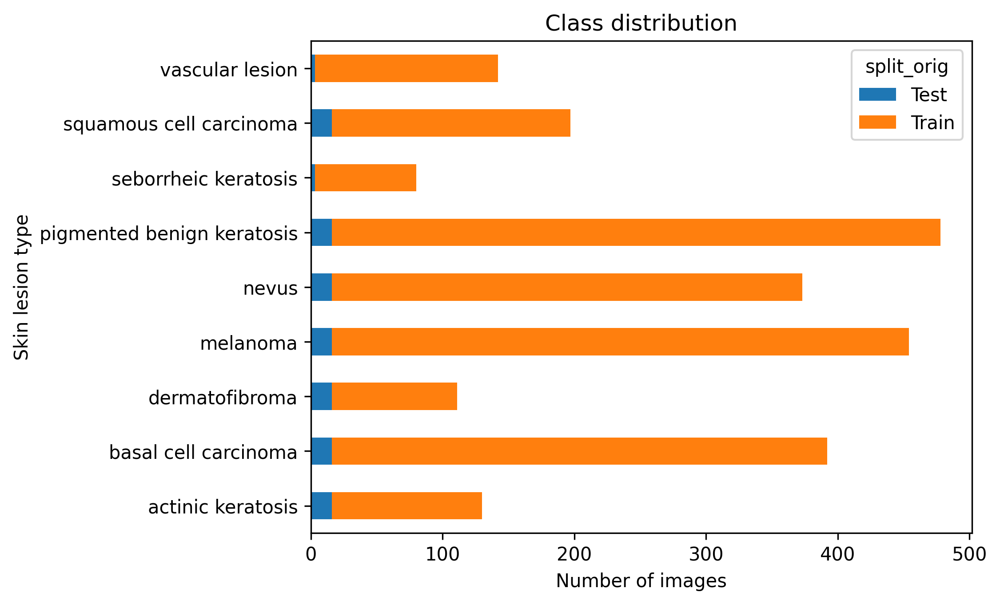

In [9]:
fig = counts.drop(["All"], axis=1).drop(["All"], axis=0).plot.barh(stacked=True)
fig.set_xlabel("Number of images")
fig.set_ylabel("Skin lesion type")
fig.set_title("Class distribution");

### 5.3.2. Previewing the Images


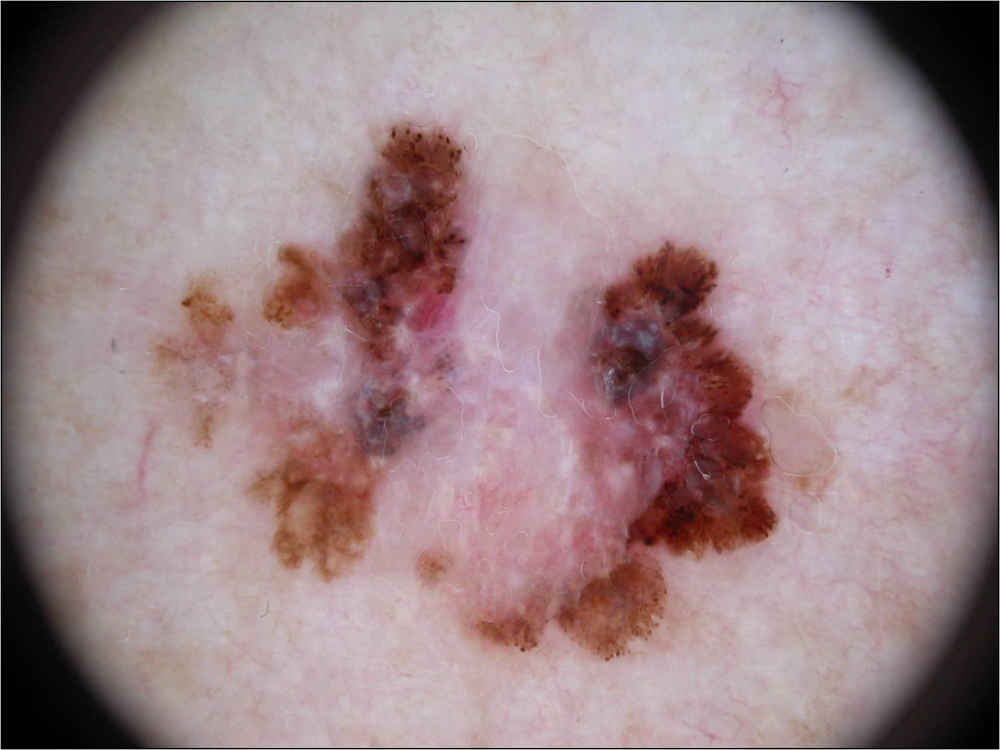

In [10]:
from PIL import Image

Image.open(metadata["full_path"].iloc[0])

In [11]:
import matplotlib.pyplot as plt


def show_random_image(metadata: pd.DataFrame, class_name: str) -> plt.Figure:
  record = (
    metadata[metadata["class_orig"] == class_name]
    .sample(1)
    .to_dict(orient="records")[0]
  )
  fig = plt.figure(figsize=(4, 4))
  plt.imshow(Image.open(record["full_path"]))
  plt.title(record["class_orig"].capitalize())
  return fig

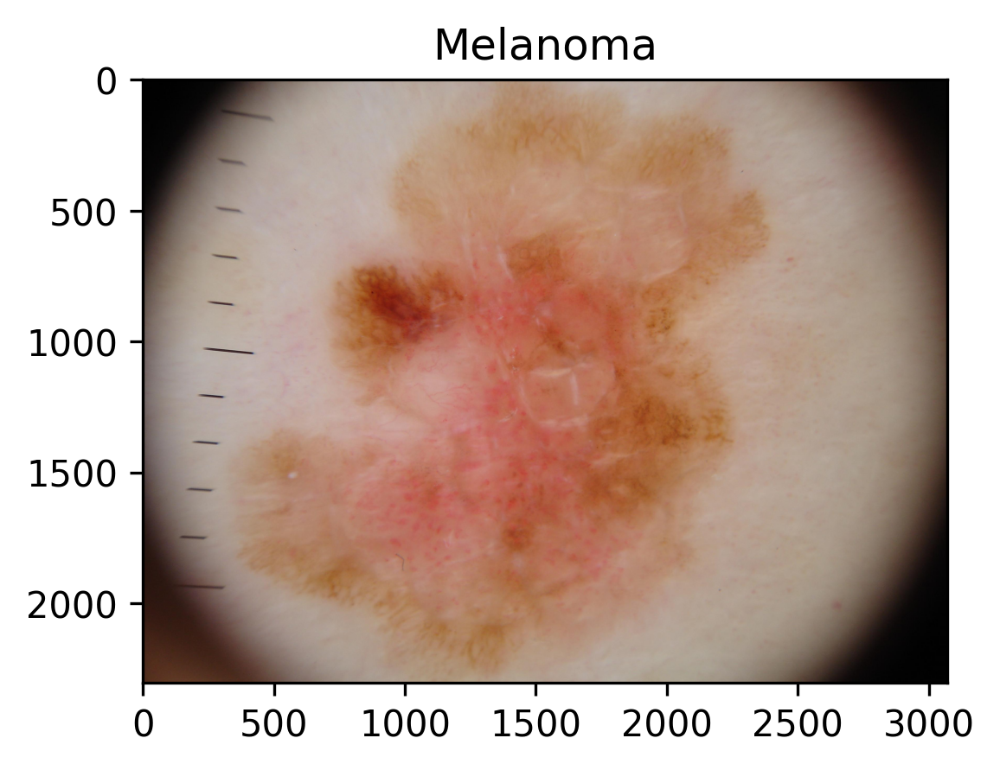

In [12]:
show_random_image(metadata, "melanoma");

In [13]:
def plot_random_image_grid(
  metadata: pd.DataFrame, ncols: int = 3
) -> plt.Figure:
  """Display a random example image from each class in a grid."""
  records = metadata.groupby("class_orig").sample(1).to_dict(orient="records")
  nrows = (len(records) + ncols - 1) // ncols
  fig, axes = plt.subplots(nrows, ncols, figsize=(10, 2.5 * nrows))
  axes = axes.flatten()

  for record, ax in zip(records, axes):
    ax.imshow(Image.open(record["full_path"]))
    ax.set_title(record["class_orig"].capitalize())
    ax.axis("off")

  plt.tight_layout()
  return fig

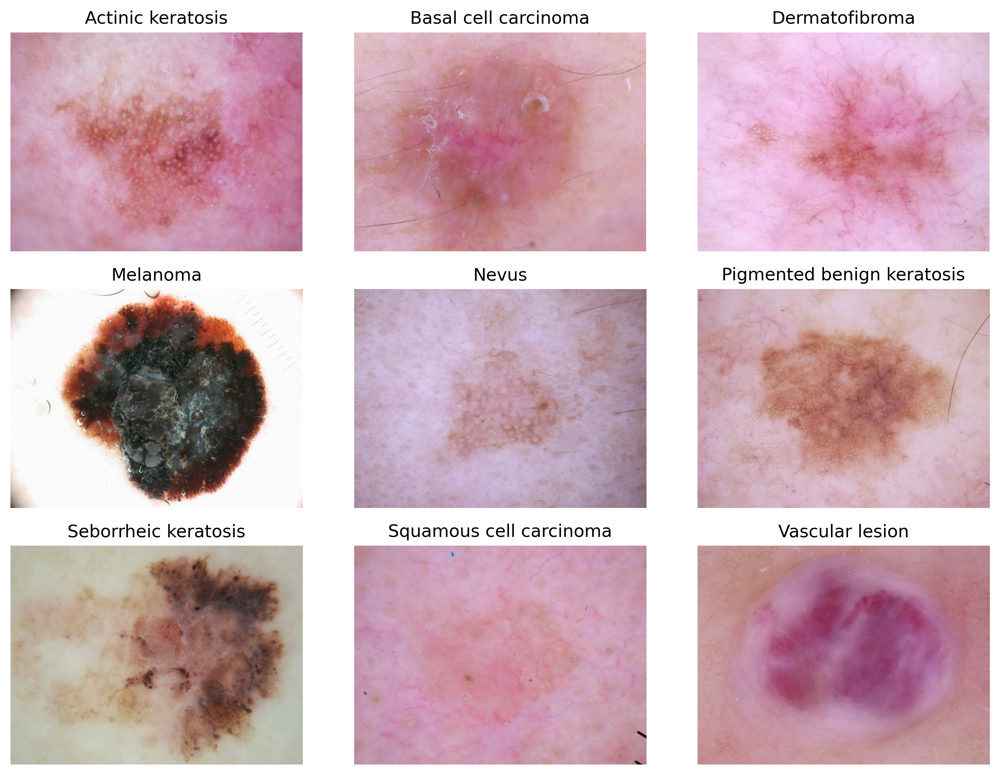

In [14]:
plot_random_image_grid(metadata);

### 5.3.3. Addressing Dataset Issues


In [16]:
import numpy as np

np.random.seed(seed=42)
splits = {"train": 0.7, "valid": 0.20, "test": 0.10}

metadata["split"] = np.random.choice(
  list(splits.keys()), p=list(splits.values()), size=metadata.shape[0]
)

counts = pd.crosstab(metadata["class_orig"], metadata["split"], margins=True)
print(counts)

split                 test  train  valid   All
class_orig                                    
actinic keratosis       13     85     32   130
basal cell carcinoma    39    284     69   392
dermatofibroma          11     84     16   111
melanoma                55    307     92   454
nevus                   41    250     82   373
pigmented benign ...    39    358     81   478
seborrheic keratosis     9     50     21    80
squamous cell car...    14    138     45   197
vascular lesion         10     99     33   142
All                    231   1655    471  2357


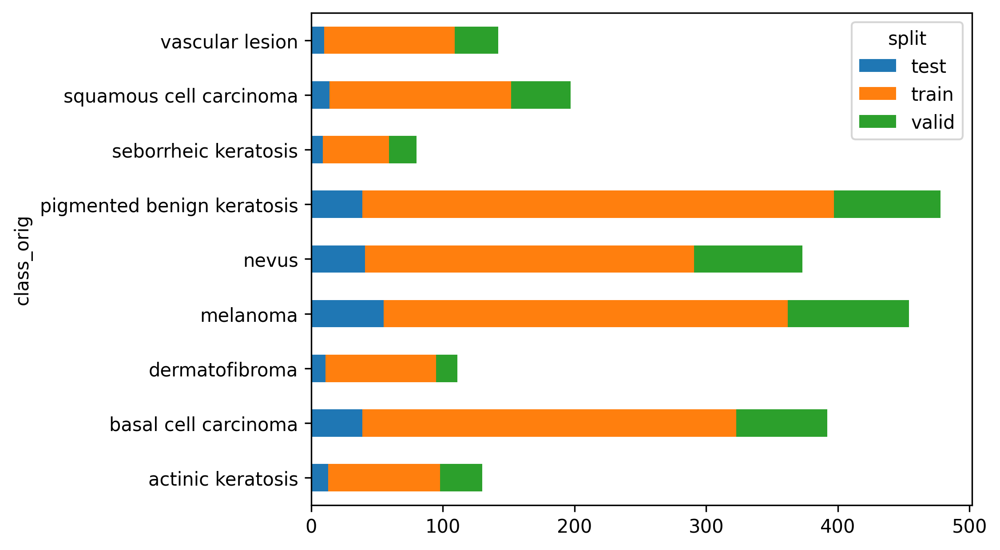

In [18]:
counts.drop(["All"], axis=1).drop(["All"], axis=0).plot.barh(stacked=True);

#### 5.3.3.1. Balancing the Batches
#### 5.3.3.2. Augmenting the Dataset


In [19]:
from dlfb.cancer.train.handlers.augmentors import rich_augmentor

display([rich_augmentor])

/usr/local/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.48, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


Some weights of the model checkpoint at microsoft/resnet-18 were not used when initializing FlaxResNetModel: {('params', 'encoder', 'stages', '2', 'layers', '0', 'layer', '0', 'convolution', 'kernel'), ('params', 'encoder', 'stages', '0', 'layers', '1', 'layer', '0', 'convolution', 'kernel'), ('params', 'classifier', '1', 'kernel'), ('batch_stats', 'encoder', 'stages', '3', 'layers', '1', 'layer', '0', 'normalization', 'mean'), ('params', 'encoder', 'stages', '2', 'layers', '0', 'layer', '0', 'normalization', 'bias'), ('batch_stats', 'encoder', 'stages', '3', 'layers', '1', 'layer', '1', 'normalization', 'var'), ('batch_stats', 'encoder', 'stages', '3', 'layers', '1', 'layer', '0', 'normalization', 'var'), ('params', 'encoder', 'stages', '1', 'layers', '1', 'layer', '1', 'normalization', 'bias'), ('batch_stats', 'encoder', 'stages', '1', 'layers', '0', 'layer', '0', 'normalization', 'var'), ('params', 'encoder', 'stages', '0', 'layers', '0', 'layer', '1', 'convolution', 'kernel'), ('pa

Some weights of FlaxResNetModel were not initialized from the model checkpoint at microsoft/resnet-18 and are newly initialized: {('batch_stats', 'encoder', 'stages', '1', 'layers', '0', 'layer', 'layer_1', 'normalization', 'var'), ('batch_stats', 'encoder', 'stages', '3', 'layers', '0', 'layer', 'layer_1', 'normalization', 'mean'), ('params', 'encoder', 'stages', '1', 'layers', '1', 'layer', 'layer_0', 'normalization', 'bias'), ('params', 'encoder', 'stages', '0', 'layers', '0', 'layer', 'layer_0', 'normalization', 'bias'), ('batch_stats', 'encoder', 'stages', '3', 'layers', '0', 'layer', 'layer_1', 'normalization', 'var'), ('batch_stats', 'encoder', 'stages', '0', 'layers', '0', 'layer', 'layer_0', 'normalization', 'mean'), ('params', 'encoder', 'stages', '1', 'layers', '0', 'layer', 'layer_0', 'convolution', 'kernel'), ('batch_stats', 'encoder', 'stages', '0', 'layers', '1', 'layer', 'layer_0', 'normalization', 'mean'), ('params', 'encoder', 'stages', '2', 'layers', '1', 'layer', 'l

Some weights of the model checkpoint at microsoft/resnet-34 were not used when initializing FlaxResNetModel: {('params', 'encoder', 'stages', '2', 'layers', '0', 'layer', '0', 'convolution', 'kernel'), ('params', 'encoder', 'stages', '0', 'layers', '2', 'layer', '1', 'convolution', 'kernel'), ('params', 'encoder', 'stages', '1', 'layers', '2', 'layer', '1', 'normalization', 'bias'), ('params', 'encoder', 'stages', '0', 'layers', '2', 'layer', '0', 'normalization', 'bias'), ('params', 'encoder', 'stages', '0', 'layers', '1', 'layer', '0', 'convolution', 'kernel'), ('params', 'encoder', 'stages', '1', 'layers', '3', 'layer', '0', 'normalization', 'bias'), ('params', 'encoder', 'stages', '2', 'layers', '5', 'layer', '0', 'normalization', 'kernel'), ('batch_stats', 'encoder', 'stages', '0', 'layers', '2', 'layer', '1', 'normalization', 'mean'), ('params', 'classifier', '1', 'kernel'), ('batch_stats', 'encoder', 'stages', '3', 'layers', '1', 'layer', '0', 'normalization', 'mean'), ('params'

Some weights of FlaxResNetModel were not initialized from the model checkpoint at microsoft/resnet-34 and are newly initialized: {('params', 'encoder', 'stages', '3', 'layers', '2', 'layer', 'layer_0', 'normalization', 'scale'), ('batch_stats', 'encoder', 'stages', '1', 'layers', '0', 'layer', 'layer_1', 'normalization', 'var'), ('params', 'encoder', 'stages', '2', 'layers', '4', 'layer', 'layer_0', 'normalization', 'scale'), ('batch_stats', 'encoder', 'stages', '1', 'layers', '3', 'layer', 'layer_0', 'normalization', 'var'), ('params', 'encoder', 'stages', '2', 'layers', '3', 'layer', 'layer_1', 'normalization', 'bias'), ('batch_stats', 'encoder', 'stages', '3', 'layers', '0', 'layer', 'layer_1', 'normalization', 'mean'), ('params', 'encoder', 'stages', '1', 'layers', '1', 'layer', 'layer_0', 'normalization', 'bias'), ('params', 'encoder', 'stages', '1', 'layers', '2', 'layer', 'layer_0', 'normalization', 'bias'), ('params', 'encoder', 'stages', '0', 'layers', '0', 'layer', 'layer_0',

@jax.jit
def rich_augmentor(image: jax.Array, rng: jax.Array) -> jax.Array:
  """Applies random flips, brightness, contrast, hue changes, and rotation."""
  image = pix.random_flip_left_right(rng, image)
  image = pix.random_flip_up_down(rng, image)
  image = pix.random_brightness(rng, image, max_delta=0.1)
  image = pix.random_contrast(rng, image, lower=0.9, upper=1)
  image = pix.random_hue(rng, image, max_delta=0.05)
  # Angles are provided in radians, i.e. +/- 10 degrees.
  image = pix.rotate(
    image,
    angle=jax.random.uniform(rng, shape=(), minval=-0.174533, maxval=0.174533),
  )
  return image

2025-06-30 15:56:31.460 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.060973816..1.0400493].


2025-06-30 15:56:32.087 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.06373504..1.0448893].


2025-06-30 15:56:32.332 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.08394898..1.0754379].


2025-06-30 15:56:32.579 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.06966046..1.0543958].


2025-06-30 15:56:32.789 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.024258351..0.9132596].


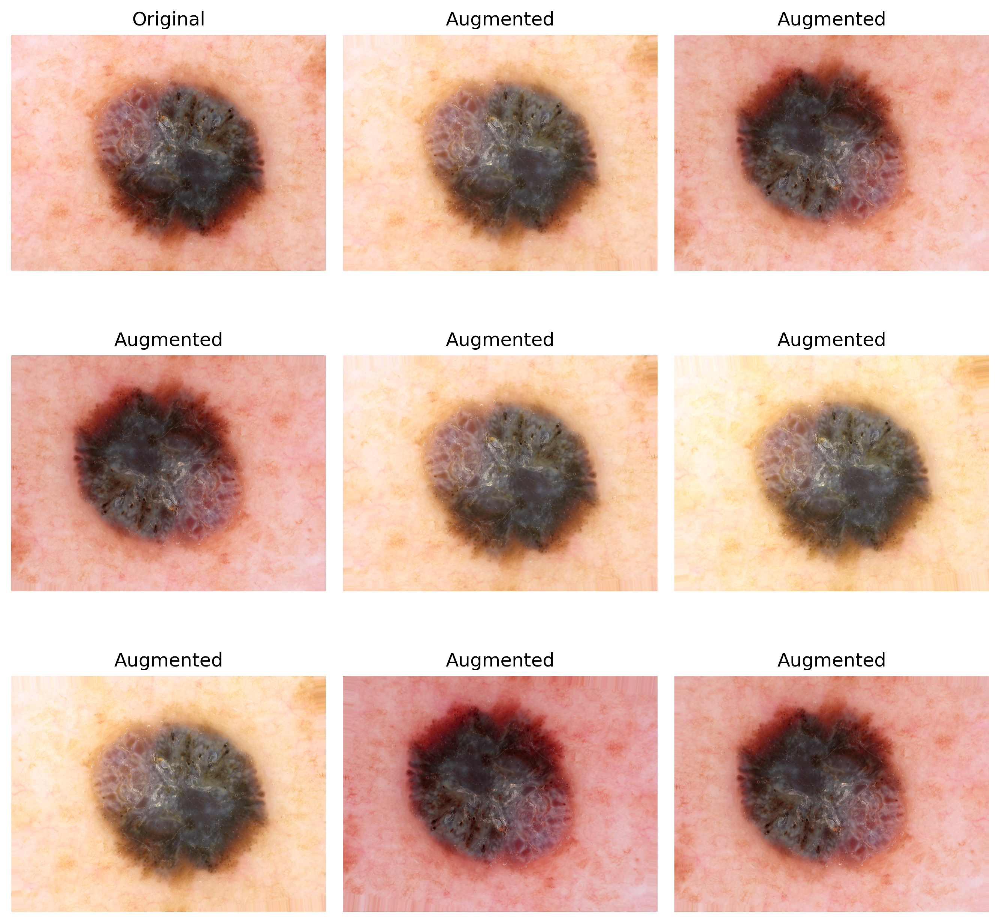

In [20]:
import jax
import jax.numpy as jnp

rng = jax.random.PRNGKey(seed=42)
image = Image.open(
  metadata[metadata["class_orig"] == "melanoma"]
  .sample(1)["full_path"]
  .values[0]
)

_, axes = plt.subplots(3, 3, figsize=(9, 9))
axes = axes.flatten()
axes[0].imshow(image)
axes[0].set_title("Original")
axes[0].axis("off")
image = jnp.asarray(image) / 255.0
for ax in axes[1:]:
  rng, rng_augment = jax.random.split(rng, num=2)
  ax.imshow(rich_augmentor(image, rng_augment))
  ax.set_title("Augmented")
  ax.axis("off")
plt.tight_layout()

#### 5.3.3.3. Preprocessing the Images


In [21]:
from dlfb.cancer.dataset.preprocessors import (
  center_crop,
  resize_preserve_aspect,
)

display([resize_preserve_aspect, center_crop])

def resize_preserve_aspect(
  image: jax.Array, short_side: int = 256
) -> jax.Array:
  """Resize image with shorter side is `short_side`, keeping aspect ratio."""
  h, w, c = image.shape
  scale = short_side / jnp.minimum(h, w)
  new_h = jnp.round(h * scale).astype(jnp.int32)
  new_w = jnp.round(w * scale).astype(jnp.int32)
  resized = jax.image.resize(image, (new_h, new_w, c), method="bilinear")
  return resized


def center_crop(image: jax.Array, size: int = 224) -> jax.Array:
  """Crop the center square of given size from an image."""
  h, w, _ = image.shape
  top = (h - size) // 2
  left = (w - size) // 2
  return image[top : top + size, left : left + size]

In [22]:
from dlfb.cancer.dataset.preprocessors import rescale_image

display([rescale_image])

def rescale_image(image: jax.Array) -> jax.Array:
  """Normalizes pixel values to the [0, 1] range by dividing by 255."""
  return image / 255.0

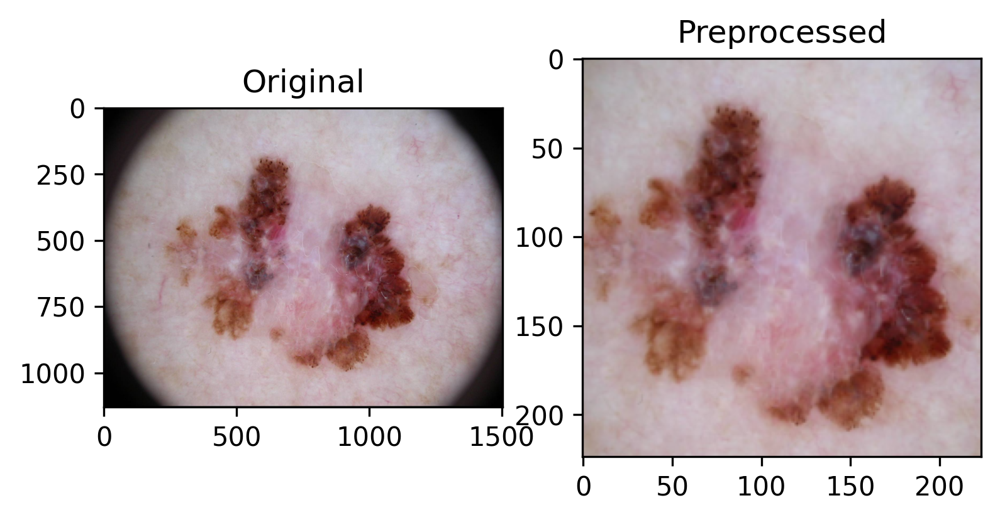

In [23]:
original_image = Image.open(metadata.iloc[0]["full_path"])
image = np.array(original_image)
image = resize_preserve_aspect(image)
image = center_crop(image)
image = rescale_image(image)

_, axes = plt.subplots(1, 2, figsize=(6, 3))
axes = axes.flatten()
axes[0].imshow(original_image)
axes[0].set_title("Original")
axes[1].imshow(image)
axes[1].set_title("Preprocessed");

#### 5.3.3.4. Data Storage with Memory-Mapped Arrays


In [24]:
from tempfile import TemporaryFile

images_on_disk = np.memmap(
  TemporaryFile(), dtype="float32", mode="w+", shape=(10, 224, 224, 3)
)
for i, full_path in enumerate(metadata[:10]["full_path"]):
  image = Image.open(full_path)
  image = np.array(image)
  image = resize_preserve_aspect(image)
  image = center_crop(image)
  image = rescale_image(image)
  images_on_disk[i, :, :, :] = image
images_on_disk.flush()

### 5.3.4. Building a DatasetBuilder


In [25]:
from dlfb.cancer.dataset.builder import DatasetBuilder

display([DatasetBuilder])

class DatasetBuilder:
  """Builds a dataset with metadata, loaded images, and class mappings."""

  def __init__(self, data_dir: str, out_dir: str | None = None) -> None:
    self.data_dir = data_dir
    self.out_dir = out_dir or data_dir

  def build(
    self,
    rng: jax.Array,
    splits: dict[str, float],
    preprocessors: list[Callable] = [crop],
    image_size: tuple[int, int, int] = (224, 224, 3),
    class_map: dict[str, Any] | None = None,
  ) -> dict[str, Dataset]:
    """Builds the dataset splits from loaded metadata and loaded images."""
    metadata = MetadataLoader(self.data_dir, self.out_dir).load(class_map)
    images = ImageLoader(metadata, self.out_dir).load(preprocessors, image_size)

    # Shuffle the dataset and assign each example to one of the dataset splits.
    num_samples = len(metadata)
    rng, rng_perm = jax.random.split(rng, 2)
    shuffled_indices = jax.random.permutation(rng_perm, num_samples)

    # Create each dataset split using the shuffled indices and store the
    # corresponding metadata and image data in a Dataset object.
    dataset_splits, start = {}, 0
    for name, size in self._get_split_sizes(splits, num_samples):
      indices = np.array(shuffled_indices[start : (start + size)])
      dataset_splits[name] = Dataset(
        metadata=metadata.iloc[indices],
        images=images,
        num_classes=metadata["class"].nunique(),
      )
      start += size
    return dataset_splits

  def _get_split_sizes(self, splits: dict[str, float], num_samples: int):
    """Convert fractional split sizes to integer counts that sum to total."""
    names = list(splits)
    sizes = [int(num_samples * splits[name]) for name in names[:-1]]
    sizes.append(num_samples - sum(sizes))  # last split gets the remainder
    yield from zip(names, sizes)

#### 5.3.4.1. Loading the Metadata and Images


In [26]:
from dlfb.cancer.dataset import Dataset

display([Dataset])

@dataclass
class Dataset:
  """Dataset class storing images and corresponding metadata."""

  metadata: pd.DataFrame
  images: Images
  num_classes: int

  def get_dummy_input(self) -> jax.Array:
    """Returns dummy input with the correct shape for the model."""
    return jnp.empty((1,) + self.images.size)

  def num_samples(self) -> int:
    """Returns the number of samples in the dataset."""
    return self.metadata.shape[0]

  def get_images(self, preprocessor: Callable, indices: jax.Array) -> jax.Array:
    """Returns preprocessed images for the given indices."""
    return self.images.loaded[preprocessor.__name__][indices]

  def get_labels(self, indices: list[int]) -> jax.Array:
    """Returns integer class labels for the given indices."""
    return jnp.int16(self.metadata.loc[indices]["label"].values)

In [27]:
from dlfb.cancer.dataset import Images

display([Images])

@dataclass
class Images:
  """Stores image data and size information."""

  loaded: dict[str, np.memmap]
  size: tuple[int, int, int]

#### 5.3.4.2. Batching the Data


In [28]:
from dlfb.cancer.train.handlers import BatchHandler

display([BatchHandler])

class BatchHandler:
  """Helper to provide appropriately prepared batches form a dataset."""

  def __init__(
    self,
    preprocessor: Callable = crop,
    sampler: Callable = epoch_sampler,
    augmentor: Callable | None = None,
  ):
    self.preprocessor = preprocessor
    self.sampler = sampler
    self.augmentor = augmentor

  def get_batches(self, dataset: Dataset, batch_size: int, rng: jax.Array):
    """Prepare dataset batches with the requested image manipulations."""
    self._validate_batch_size(dataset, batch_size)
    rng, rng_sampler = jax.random.split(rng, num=2)

    for batch_indices in self.sampler(
      dataset.metadata, batch_size, rng_sampler
    ):
      images = dataset.get_images(self.preprocessor, batch_indices)

      if self.augmentor is not None:
        rng, rng_augment = jax.random.split(rng, 2)
        images = jax.vmap(lambda image, r: self.augmentor(image, rng=r))(
          images, jax.random.split(rng_augment, images.shape[0])
        )

      batch = {
        "frame_ids": batch_indices,
        "images": images,
        "labels": dataset.get_labels(batch_indices),
      }
      yield batch

  @staticmethod
  def _validate_batch_size(dataset: Dataset, batch_size: int) -> None:
    """Ensures that batch_size is within feasible bounds."""
    if batch_size > dataset.num_samples():
      raise ValueError(
        f"Batch size ({batch_size}) cannot be larger than dataset size "
        "({len(frame_ids)})."
      )
    if batch_size < dataset.num_classes:
      raise ValueError(
        f"batch_size ({batch_size}) has to be larger than "
        f"number of unique labels."
      )

### 5.3.5. Readying the Dataset


In [29]:
from dlfb.cancer.train.handlers.augmentors import rich_augmentor
from dlfb.cancer.train.handlers.samplers import balanced_sampler

rng = jax.random.PRNGKey(seed=42)
rng, rng_dataset = jax.random.split(rng, 2)

builder = DatasetBuilder(data_dir=assets("cancer/datasets/raw"))

dataset_splits = builder.build(
  rng=rng_dataset,
  splits={"train": 0.7, "valid": 0.20, "test": 0.10},
  image_size=(224, 224, 3),
)

print(dataset_splits["train"].metadata)

      frame_id split_orig           class_orig            full_path  label  \
177        177      Train    actinic keratosis  /content/drive/M...      0   
408        408      Train  basal cell carci...  /content/drive/M...      1   
445        445      Train  basal cell carci...  /content/drive/M...      1   
...        ...        ...                  ...                  ...    ...   
1579      1579      Train  pigmented benign...  /content/drive/M...      5   
1966      1966      Train  seborrheic kerat...  /content/drive/M...      6   
305        305      Train  basal cell carci...  /content/drive/M...      1   

                    class  
177     actinic keratosis  
408   basal cell carci...  
445   basal cell carci...  
...                   ...  
1579  pigmented benign...  
1966  seborrheic kerat...  
305   basal cell carci...  

[1649 rows x 6 columns]


In [30]:
rng, rng_train = jax.random.split(rng, 2)

train_batcher = BatchHandler(sampler=balanced_sampler, augmentor=rich_augmentor)
train_batches = train_batcher.get_batches(
  dataset_splits["train"], batch_size=32, rng=rng_train
)
batch = next(train_batches)

In [31]:
batch["images"].shape

(32, 224, 224, 3)

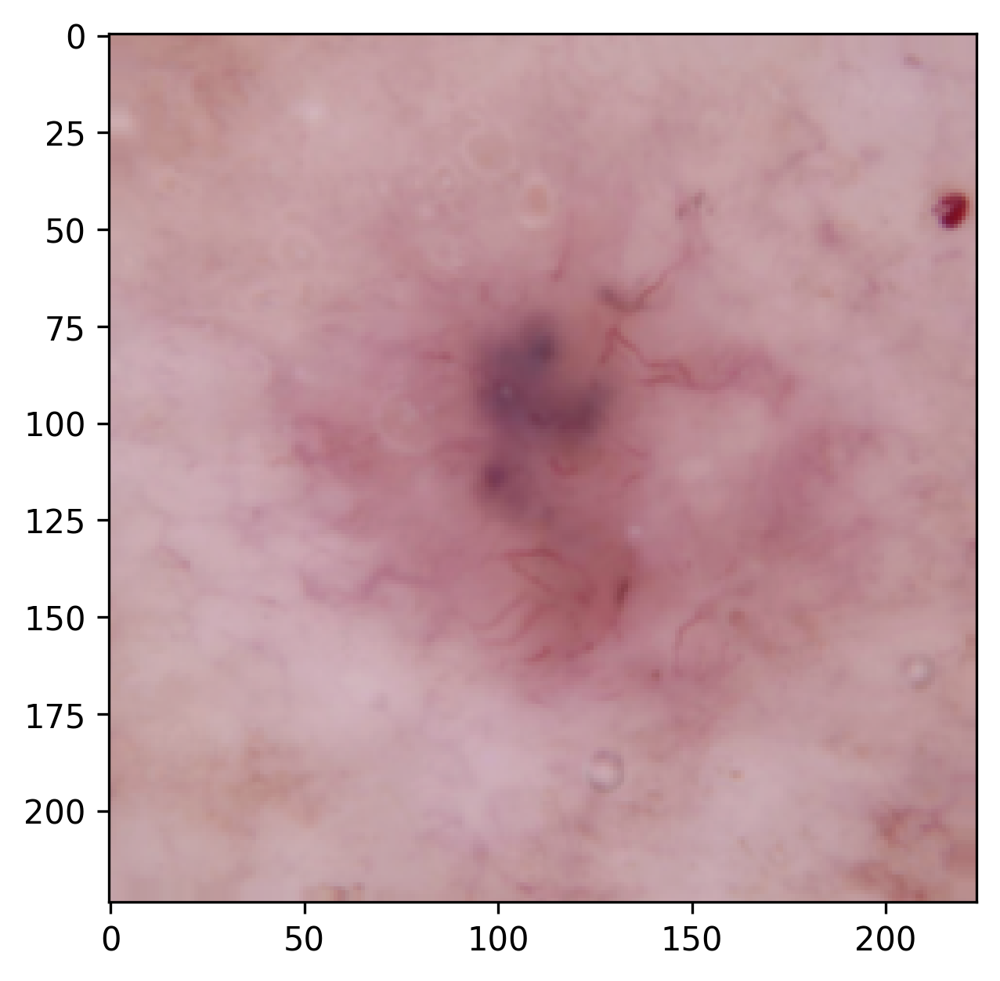

In [32]:
plt.imshow(batch["images"][0]);

## 5.4. Building Skin Cancer Classification Models
### 5.4.1. Loading the Flax ResNet50 Model


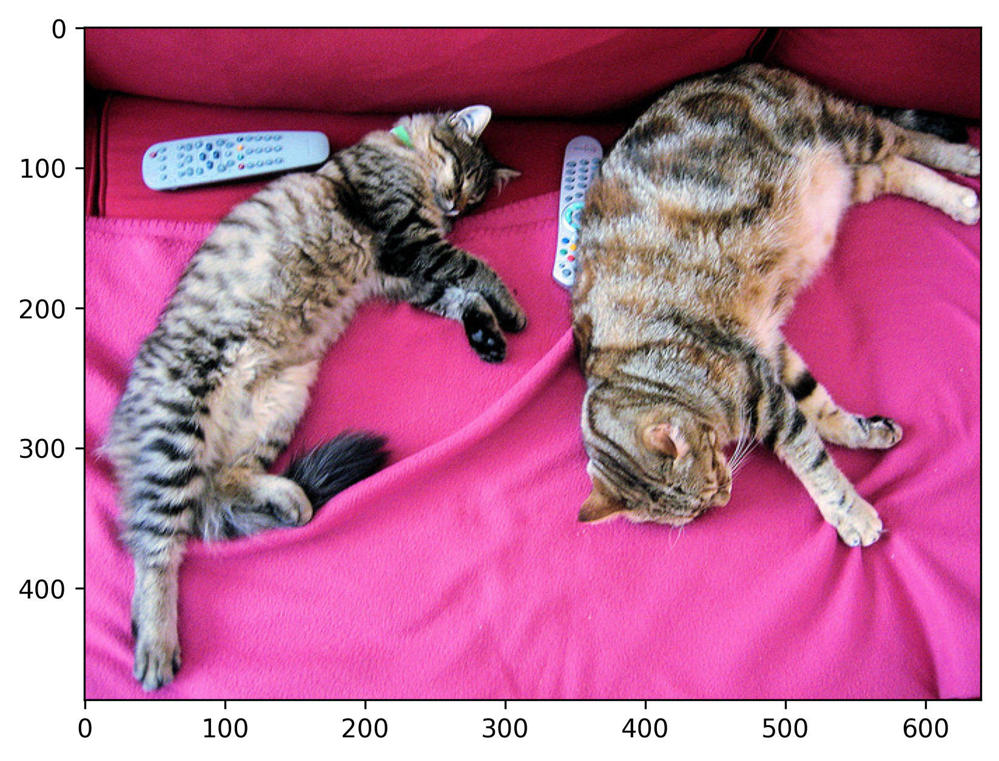

In [3]:
import requests

# Load the example image from the documentation.
url = "http://images.cocodataset.org/val2017/000000039769.jpg"
image = Image.open(requests.get(url, stream=True).raw)
plt.imshow(image);

In [4]:
from transformers import AutoImageProcessor, FlaxResNetForImageClassification

resnet_model = FlaxResNetForImageClassification.from_pretrained(
  "microsoft/resnet-50"
)
image_processor = AutoImageProcessor.from_pretrained("microsoft/resnet-50")

/usr/local/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.48, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


In [5]:
inputs = image_processor(images=image, return_tensors="jax")
inputs.keys()

dict_keys(['pixel_values'])

2025-06-30 15:56:47.656 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


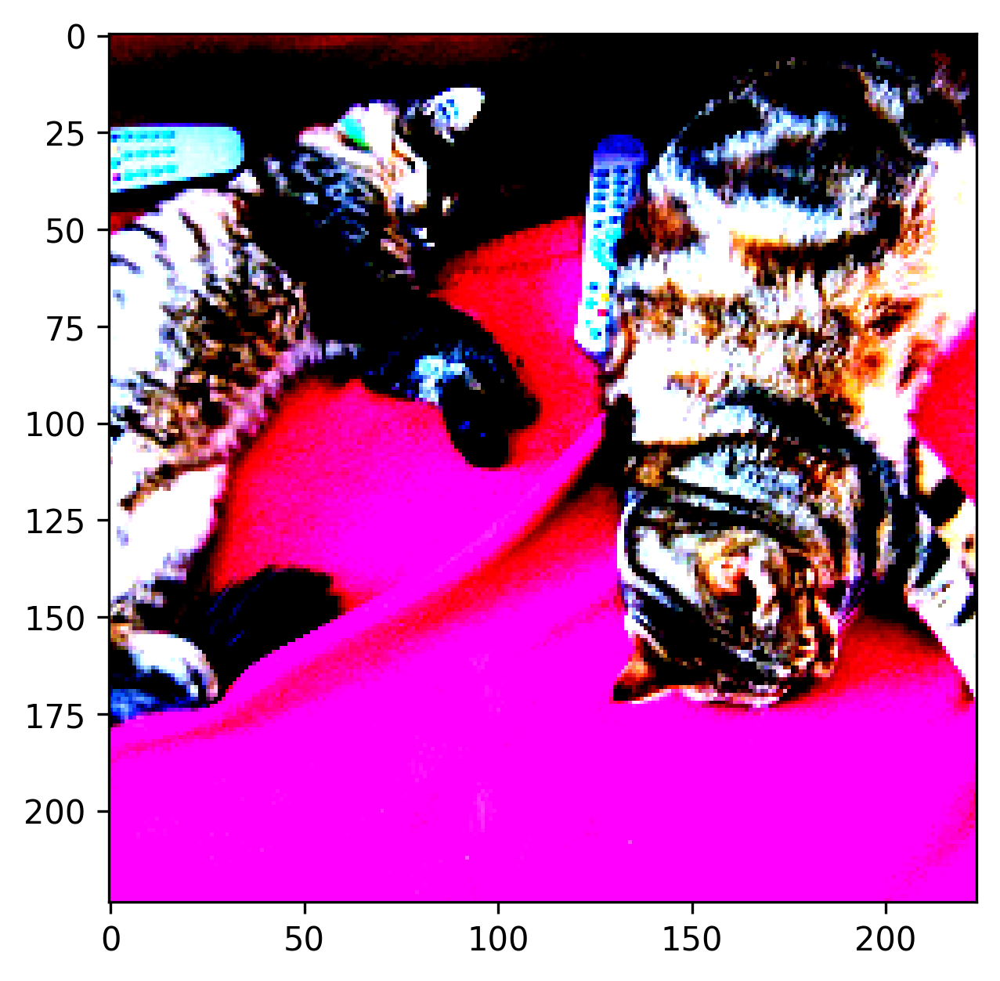

In [6]:
plt.imshow(jnp.transpose(inputs["pixel_values"], (0, 2, 3, 1))[0]);

In [7]:
outputs = resnet_model(**inputs)
logits = outputs.logits
predicted_class_idx = jnp.argmax(logits, axis=-1)
print(
  "Predicted class:", resnet_model.config.id2label[predicted_class_idx.item()]
)

Predicted class: tiger cat


### 5.4.2. Extracting the ResNet Backbone


In [8]:
module, variables = resnet_model.module, resnet_model.params
backbone_module, backbone_vars = module.bind(variables).resnet.unbind()

In [9]:
outputs = backbone_module.apply(
  backbone_vars, jnp.transpose(inputs["pixel_values"], (0, 2, 3, 1))
)
last_hidden_state = outputs.last_hidden_state
last_hidden_state.shape

(1, 2048, 7, 7)

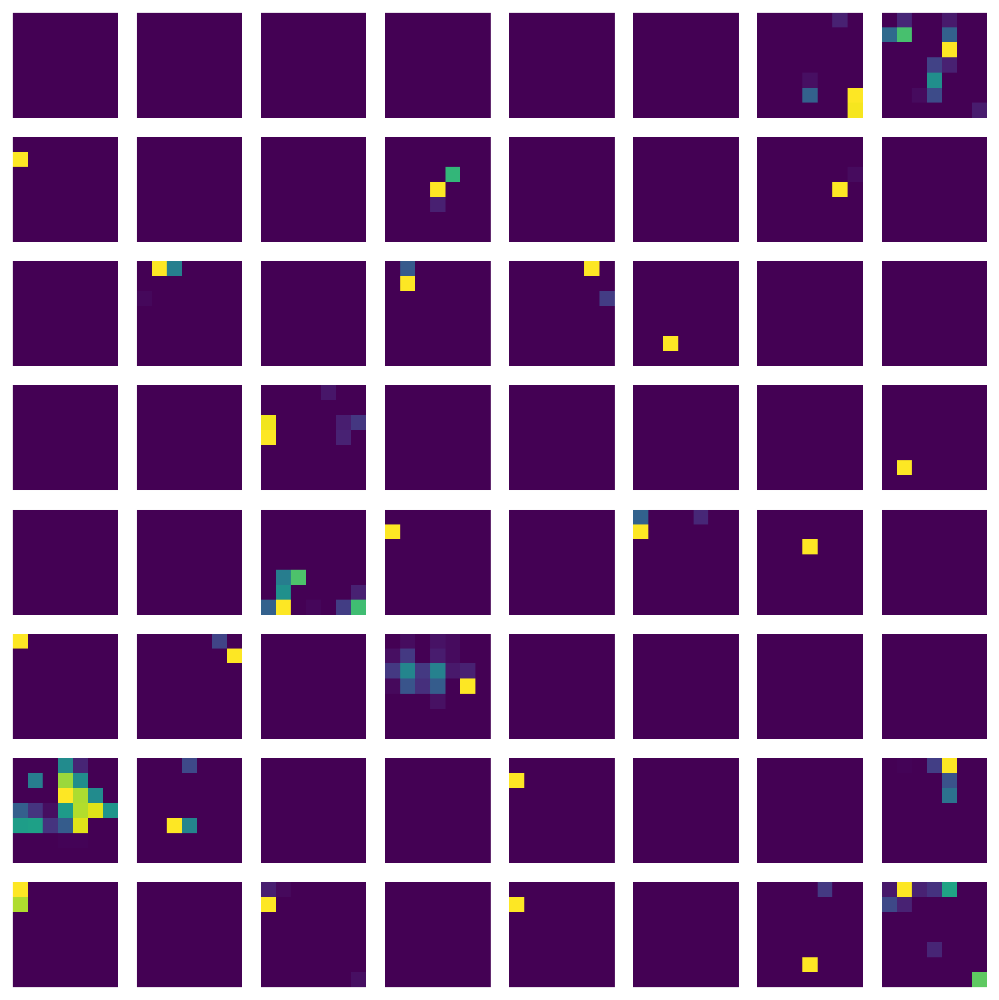

In [10]:
def display_feature_maps(feature_map, ncols=8):
  """Plot grid of the first 64 feature maps."""
  num_features = feature_map.shape[0]
  nrows = (num_features + ncols - 1) // ncols
  _, axes = plt.subplots(nrows, ncols, figsize=(ncols, nrows))
  axes = axes.flatten()

  for i, (ax, feature) in enumerate(zip(axes, feature_map)):
    ax.imshow(feature, cmap="viridis")
    ax.axis("off")

  plt.tight_layout()
  plt.show()


display_feature_maps(last_hidden_state[0, 0:64, ...])

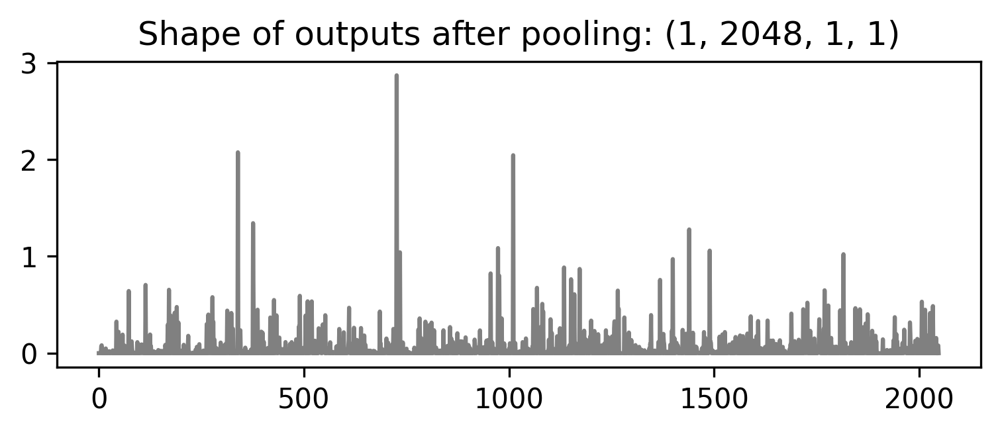

In [11]:
_, ax = plt.subplots(1, 1, figsize=(6, 2))
ax.plot(np.squeeze(outputs.pooler_output), c="grey")
plt.title(f"Shape of outputs after pooling: {outputs.pooler_output.shape}");

### 5.4.3. Building the SkinLesionClassifierHead


In [12]:
from dlfb.cancer.model import SkinLesionClassifierHead

display([SkinLesionClassifierHead])

Some weights of the model checkpoint at microsoft/resnet-18 were not used when initializing FlaxResNetModel: {('params', 'encoder', 'stages', '1', 'layers', '0', 'layer', '0', 'convolution', 'kernel'), ('params', 'encoder', 'stages', '3', 'layers', '1', 'layer', '1', 'normalization', 'kernel'), ('batch_stats', 'encoder', 'stages', '2', 'layers', '1', 'layer', '1', 'normalization', 'var'), ('batch_stats', 'encoder', 'stages', '2', 'layers', '0', 'layer', '1', 'normalization', 'var'), ('batch_stats', 'encoder', 'stages', '1', 'layers', '1', 'layer', '1', 'normalization', 'var'), ('params', 'encoder', 'stages', '2', 'layers', '0', 'layer', '1', 'normalization', 'kernel'), ('params', 'encoder', 'stages', '1', 'layers', '0', 'layer', '1', 'normalization', 'bias'), ('params', 'encoder', 'stages', '3', 'layers', '1', 'layer', '0', 'normalization', 'bias'), ('params', 'encoder', 'stages', '1', 'layers', '1', 'layer', '1', 'normalization', 'bias'), ('params', 'encoder', 'stages', '1', 'layers',

Some weights of FlaxResNetModel were not initialized from the model checkpoint at microsoft/resnet-18 and are newly initialized: {('batch_stats', 'encoder', 'stages', '2', 'layers', '1', 'layer', 'layer_1', 'normalization', 'var'), ('batch_stats', 'encoder', 'stages', '3', 'layers', '0', 'layer', 'layer_1', 'normalization', 'mean'), ('batch_stats', 'encoder', 'stages', '2', 'layers', '0', 'layer', 'layer_1', 'normalization', 'var'), ('params', 'encoder', 'stages', '3', 'layers', '0', 'layer', 'layer_0', 'convolution', 'kernel'), ('batch_stats', 'encoder', 'stages', '1', 'layers', '1', 'layer', 'layer_1', 'normalization', 'var'), ('params', 'encoder', 'stages', '1', 'layers', '1', 'layer', 'layer_0', 'normalization', 'scale'), ('batch_stats', 'encoder', 'stages', '1', 'layers', '0', 'layer', 'layer_1', 'normalization', 'mean'), ('params', 'encoder', 'stages', '0', 'layers', '1', 'layer', 'layer_0', 'convolution', 'kernel'), ('params', 'encoder', 'stages', '1', 'layers', '1', 'layer', 'l

Some weights of the model checkpoint at microsoft/resnet-34 were not used when initializing FlaxResNetModel: {('params', 'encoder', 'stages', '2', 'layers', '5', 'layer', '0', 'normalization', 'bias'), ('params', 'encoder', 'stages', '2', 'layers', '2', 'layer', '1', 'convolution', 'kernel'), ('params', 'encoder', 'stages', '1', 'layers', '0', 'layer', '0', 'convolution', 'kernel'), ('params', 'encoder', 'stages', '3', 'layers', '1', 'layer', '1', 'normalization', 'kernel'), ('batch_stats', 'encoder', 'stages', '1', 'layers', '3', 'layer', '0', 'normalization', 'var'), ('params', 'encoder', 'stages', '3', 'layers', '2', 'layer', '0', 'convolution', 'kernel'), ('params', 'encoder', 'stages', '2', 'layers', '1', 'layer', '1', 'normalization', 'kernel'), ('params', 'encoder', 'stages', '2', 'layers', '4', 'layer', '0', 'convolution', 'kernel'), ('params', 'encoder', 'stages', '0', 'layers', '2', 'layer', '0', 'normalization', 'bias'), ('batch_stats', 'encoder', 'stages', '2', 'layers', '1

Some weights of FlaxResNetModel were not initialized from the model checkpoint at microsoft/resnet-34 and are newly initialized: {('batch_stats', 'encoder', 'stages', '2', 'layers', '1', 'layer', 'layer_1', 'normalization', 'var'), ('params', 'encoder', 'stages', '2', 'layers', '3', 'layer', 'layer_1', 'normalization', 'bias'), ('batch_stats', 'encoder', 'stages', '3', 'layers', '0', 'layer', 'layer_1', 'normalization', 'mean'), ('batch_stats', 'encoder', 'stages', '2', 'layers', '2', 'layer', 'layer_0', 'normalization', 'mean'), ('batch_stats', 'encoder', 'stages', '2', 'layers', '0', 'layer', 'layer_1', 'normalization', 'var'), ('params', 'encoder', 'stages', '3', 'layers', '0', 'layer', 'layer_0', 'convolution', 'kernel'), ('batch_stats', 'encoder', 'stages', '1', 'layers', '1', 'layer', 'layer_1', 'normalization', 'var'), ('params', 'encoder', 'stages', '1', 'layers', '1', 'layer', 'layer_0', 'normalization', 'scale'), ('batch_stats', 'encoder', 'stages', '1', 'layers', '0', 'layer

class SkinLesionClassifierHead(nn.Module):
  """Skin lesion classification MLP head."""

  num_classes: int
  dropout_rate: float

  @nn.compact
  def __call__(self, x, is_training: bool):
    x = nn.Dense(256, kernel_init=nn.initializers.xavier_uniform())(x)
    x = nn.relu(x)
    x = nn.Dropout(rate=self.dropout_rate)(x, deterministic=not is_training)
    x = nn.Dense(128, kernel_init=nn.initializers.xavier_uniform())(x)
    x = nn.relu(x)
    x = nn.Dropout(rate=self.dropout_rate)(x, deterministic=not is_training)
    x = nn.Dense(
      self.num_classes, kernel_init=nn.initializers.xavier_uniform()
    )(x)
    return x

### 5.4.4. Building Our Models
#### 5.4.4.1. SimpleCNN Model as a Baseline


In [13]:
from dlfb.cancer.model.cnn import SimpleCnn

display([SimpleCnn])

class SimpleCnn(nn.Module):
  """Simple CNN model with small convolutional backbone and classifier head."""

  num_classes: int
  dropout_rate: float = 0.0

  def setup(self):
    """Initializes the CNN backbone and classification head."""
    self.backbone = CnnBackbone()
    self.head = SkinLesionClassifierHead(self.num_classes, self.dropout_rate)

  @nn.compact
  def __call__(self, x, is_training: bool = False):
    """Applies the backbone and classifier head to the input."""
    x = self.backbone(x)
    x = self.head(x, is_training=is_training)
    return x

  def create_train_state(
    self, rng: jax.Array, dummy_input, tx
  ) -> TrainStateWithBatchNorm:
    """Creates the training state with initialized parameters."""
    rng, rng_init, rng_dropout = jax.random.split(rng, 3)
    variables = self.init(rng_init, dummy_input)
    state = TrainStateWithBatchNorm.create(
      apply_fn=self.apply,
      tx=tx,
      params=variables["params"],
      batch_stats=None,
      key=rng_dropout,
    )
    return state

In [14]:
from dlfb.cancer.model.cnn import CnnBackbone

display([CnnBackbone])

class CnnBackbone(nn.Module):
  """Compact convolutional feature extractor for image data."""

  @nn.compact
  def __call__(self, x):
    """Applies two conv-pool blocks and a dense layer to the input."""
    x = nn.Conv(features=32, kernel_size=(3, 3))(x)
    x = nn.relu(x)
    x = nn.avg_pool(x, window_shape=(2, 2), strides=(2, 2))
    x = nn.Conv(features=64, kernel_size=(3, 3))(x)
    x = nn.relu(x)
    x = nn.avg_pool(x, window_shape=(2, 2), strides=(2, 2))
    x = x.reshape((x.shape[0], -1))  # flatten
    x = nn.Dense(features=256)(x)
    return x

In [15]:
from dlfb.cancer.model import TrainStateWithBatchNorm

display([TrainStateWithBatchNorm])

class TrainStateWithBatchNorm(train_state.TrainState):
  """Train state that tracks batch statistics and a PRNG key."""

  batch_stats: dict | None
  key: jax.Array

#### 5.4.4.2. Building the ResNetFromScratch Model


In [16]:
from dlfb.cancer.model.resnet import ResNetFromScratch

display([ResNetFromScratch])

class ResNetFromScratch(nn.Module):
  """ResNet model initialized from scratch with a custom classification head."""

  num_classes: int
  layers: int = 50
  dropout_rate: float = 0.0

  def setup(self):
    """Initializes the backbone and classification head."""
    self.backbone = PRETRAINED_RESNETS[self.layers].module
    self.head = SkinLesionClassifierHead(self.num_classes, self.dropout_rate)

  def __call__(self, x, is_training: bool = False):
    """Runs a forward pass through the model."""
    x = self.backbone(x, deterministic=not is_training).pooler_output
    x = jnp.squeeze(x, axis=(2, 3))
    x = self.head(x, is_training=is_training)
    return x

  def create_train_state(
    self, rng: jax.Array, dummy_input, tx
  ) -> TrainStateWithBatchNorm:
    """Initializes model parameters and optimizer state."""
    rng, rng_init, rng_dropout = jax.random.split(rng, 3)
    variables = self.init(rng_init, dummy_input, is_training=False)
    variables = self.transfer_parameters(variables)
    tx = self.set_trainable_parameters(tx, variables)
    state = TrainStateWithBatchNorm.create(
      apply_fn=self.apply,
      tx=tx,
      params=variables["params"],
      batch_stats=variables["batch_stats"],
      key=rng_dropout,
    )
    return state

  def transfer_parameters(_, variables):
    """Returns variables unchanged (no transfer learning)."""
    return variables

  @staticmethod
  def set_trainable_parameters(tx, _):
    """Returns optimizer configuration with all parameters trainable."""
    return tx

# 6. Dictionary of pretrained ResNet models from Hugging Face.
#### 6.0.0.1. Building the FinetunedResNet Model


In [17]:
from dlfb.cancer.model.resnet import FinetunedResNet

display([FinetunedResNet])

class FinetunedResNet(ResNetFromScratch):
  """ResNet model with pretrained weights and full fine-tuning."""

  def transfer_parameters(self, variables):
    """Replaces model parameters with pretrained ResNet weights."""
    resnet_variables = PRETRAINED_RESNETS[self.layers].params
    variables["params"]["backbone"] = resnet_variables["params"]
    variables["batch_stats"]["backbone"] = resnet_variables["batch_stats"]
    return variables

#### 6.0.0.2. Freezing the Backbone with FinetunedHeadResNet


In [18]:
from dlfb.cancer.model.resnet import FinetunedHeadResNet

display([FinetunedHeadResNet])

class FinetunedHeadResNet(FinetunedResNet):
  """ResNet model with a frozen backbone and trainable classification head."""

  @staticmethod
  def set_trainable_parameters(tx, variables):
    """Freezes backbone parameters and trains only the classification head."""
    return optax.multi_transform(
      transforms={"trainable": tx, "frozen": optax.set_to_zero()},
      param_labels=traverse_util.path_aware_map(
        lambda path, _: "frozen" if "backbone" in path else "trainable",
        variables["params"],
      ),
    )

#### 6.0.0.3. More Customization Options


In [19]:
from dlfb.cancer.model.resnet import PartiallyFinetunedResNet

display([PartiallyFinetunedResNet])

class PartiallyFinetunedResNet(FinetunedResNet):
  """ResNet model with selective fine-tuning of deeper layers."""

  @staticmethod
  def set_trainable_parameters(tx, variables):
    """Freezes early layers, fine-tunes other layers at variable LR."""

    def label_fn(path, _):
      joined = "/".join(path)
      if "backbone" in path:
        if "stages/3" in joined:
          return "reduced_lr"
        return "frozen"
      return "trainable"

    return optax.multi_transform(
      transforms={
        "trainable": tx,
        "reduced_lr": optax.adam(learning_rate=1e-5),
        "frozen": optax.set_to_zero(),
      },
      param_labels=traverse_util.path_aware_map(label_fn, variables["params"]),
    )

## 6.1. Training the Models
### 6.1.1. The Training Loop


In [3]:
from dlfb.cancer.train import train

display([train])

@restorable
def train(
  state: TrainStateWithBatchNorm,
  rng: jax.Array,
  dataset_splits: dict[str, Dataset],
  num_steps: int,
  batch_size: int,
  preprocessor: Callable = crop,
  sampler: Callable = repeating_sampler,
  augmentor: Callable = None,
  eval_every: int = 10,
) -> tuple[TrainStateWithBatchNorm, dict]:
  """Trains a model using the provided dataset splits and logs metrics."""
  # Setup with metrics logger and classes numbers.
  num_classes = dataset_splits["train"].num_classes
  metrics = MetricsLogger()

  # Get train batch iterator from which to take batches.
  rng, rng_train, rng_eval = jax.random.split(rng, 3)
  train_batcher = BatchHandler(preprocessor, sampler, augmentor)
  train_batches = train_batcher.get_batches(
    dataset_splits["train"], batch_size, rng_train
  )

  steps = tqdm(range(num_steps))  # Steps with progress bar.
  for step in steps:
    steps.set_description(f"Step {step + 1}")

    rng, rng_dropout = jax.random.split(rng, 2)
    train_batch = next(train_batches)
    state, batch_metrics = train_step(
      state, train_batch, rng_dropout, num_classes
    )
    metrics.log_step(split="train", **batch_metrics)

    if step % eval_every == 0:
      for batch in BatchHandler(preprocessor).get_batches(
        dataset_splits["valid"], batch_size, rng_eval
      ):
        batch_metrics = eval_step(state, batch, num_classes)
        metrics.log_step(split="valid", **batch_metrics)
      metrics.flush(step=step)

    steps.set_postfix_str(metrics.latest(["loss"]))

  return state, metrics.export()

#### 6.1.1.1. The Training Step


In [4]:
from dlfb.cancer.train import train_step

display([train_step])

@partial(jax.jit, static_argnums=(3,))
def train_step(
  state: TrainStateWithBatchNorm,
  batch: dict[str, list[Any]],
  rng_dropout: jax.Array,
  num_classes: int,
) -> tuple[TrainStateWithBatchNorm, dict[str, jax.Array]]:
  """Performs a single training step and returns updated state and metrics."""

  def calculate_loss(params, images, labels):
    variables, kwargs = {"params": params}, {"mutable": []}
    if state.batch_stats is not None:
      variables.update({"batch_stats": state.batch_stats})
      kwargs.update({"mutable": ["batch_stats"]})
    logits, updates = state.apply_fn(
      variables,
      x=images,
      is_training=True,
      rngs={"dropout": rng_dropout},
      **kwargs,
    )
    loss = optax.softmax_cross_entropy_with_integer_labels(
      logits, labels
    ).mean()
    return loss, (logits, updates)

  grad_fn = jax.value_and_grad(calculate_loss, has_aux=True)
  (loss, (logits, updates)), grads = grad_fn(
    state.params, batch["images"], batch["labels"]
  )
  state = state.apply_gradients(grads=grads)
  if state.batch_stats is not None:
    state = state.replace(batch_stats=updates["batch_stats"])

  metrics = {
    "loss": loss,
    **compute_metrics(batch["labels"], logits, num_classes),
  }

  return state, metrics

#### 6.1.1.2. The Evaluation Step


In [5]:
from dlfb.cancer.train import eval_step

display([eval_step])

@partial(jax.jit, static_argnums=(2,))
def eval_step(
  state: TrainStateWithBatchNorm, batch: dict[str, Any], num_classes: int
):
  """Evaluates model performance on a batch and computes metrics."""
  variables, kwargs = {"params": state.params}, {}
  if state.batch_stats is not None:
    variables.update({"batch_stats": state.batch_stats})
    kwargs.update({"mutable": False})

  logits = state.apply_fn(
    variables, x=batch["images"], is_training=False, **kwargs
  )
  loss = optax.softmax_cross_entropy_with_integer_labels(
    logits, batch["labels"]
  ).mean()

  metrics = {
    "loss": loss,
    **compute_metrics(batch["labels"], logits, num_classes),
  }
  return metrics

#### 6.1.1.3. Evaluation Metrics


In [6]:
from dlfb.cancer.train import compute_metrics

display([compute_metrics])

@partial(jax.jit, static_argnums=(2,))
def compute_metrics(
  y_true: jax.Array, logits: jax.Array, n_labels: jax.Array
) -> dict[str, jax.Array]:
  """Computes weighted precision and recall metrics from logits and labels."""
  y_scores = jax.nn.softmax(logits)
  y_pred = jnp.argmax(y_scores, axis=1)
  metrics = {
    "recall_weighted": recall_score(
      y_true, y_pred, n_labels, average="weighted"
    ),
    "precision_weighted": precision_score(
      y_true, y_pred, n_labels, average="weighted"
    ),
  }
  return metrics

#### 6.1.1.4. Faster Evaluation Metrics
### 6.1.2. Creating the Multiclass Dataset


In [ ]:
from dlfb.cancer.dataset.preprocessors import skew, crop, resnet

rng = jax.random.PRNGKey(seed=42)
rng, rng_dataset, rng_init, rng_train = jax.random.split(rng, num=4)

dataset_splits = DatasetBuilder(
  data_dir=assets("cancer/datasets/raw"),
).build(
  rng=rng_dataset,
  preprocessors=[skew, crop, resnet],
  image_size=(224, 224, 3),
  splits={"train": 0.70, "valid": 0.20, "test": 0.10},
)

num_classes = dataset_splits["train"].num_classes

### 6.1.3. Training the Baseline Model


In [8]:
import optax

from dlfb.cancer.train.handlers.samplers import repeating_sampler
from dlfb.cancer.utils import decay_mask

learning_rate = 0.001
num_steps = 2000

state, metrics = train(
  state=SimpleCnn(num_classes=num_classes).create_train_state(
    rng=rng_init,
    dummy_input=dataset_splits["train"].get_dummy_input(),
    tx=optax.adamw(learning_rate, weight_decay=0.0, mask=decay_mask),
  ),
  rng=rng_train,
  dataset_splits=dataset_splits,
  num_steps=num_steps,
  batch_size=32,
  preprocessor=crop,
  sampler=repeating_sampler,
  augmentor=None,
  eval_every=100,
  store_path=assets("cancer/models/baseline"),
)

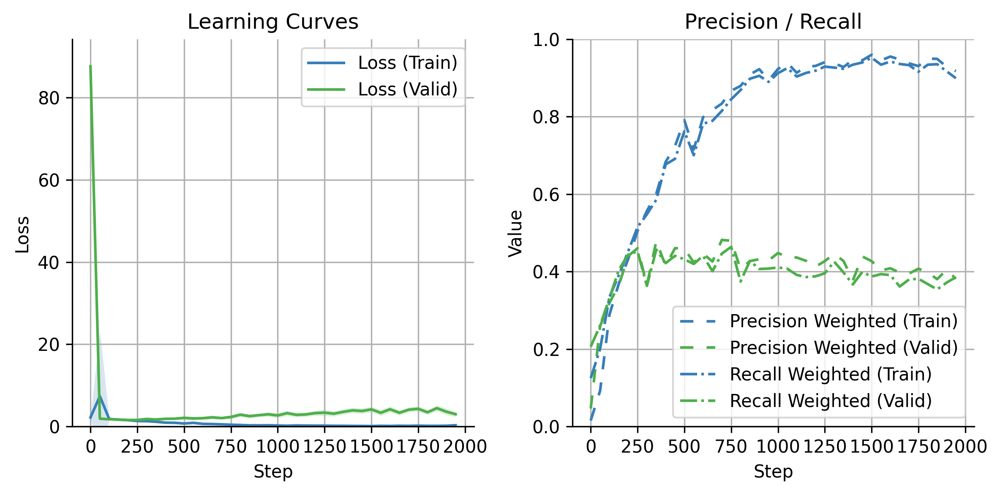

In [9]:
from dlfb.cancer.inspect import plot_learning

plot_learning(metrics);

2025-07-01 15:35:58.395 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.3278660774230957..1.000000238418579].


2025-07-01 15:35:58.502 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.00348933064378798..1.000000238418579].


2025-07-01 15:35:58.506 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.1883126050233841..1.000000238418579].


2025-07-01 15:35:58.560 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.02210531383752823..1.0000003576278687].


2025-07-01 15:35:58.622 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.2505095303058624..1.000000238418579].


2025-07-01 15:35:58.643 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.03873390331864357..1.000000238418579].


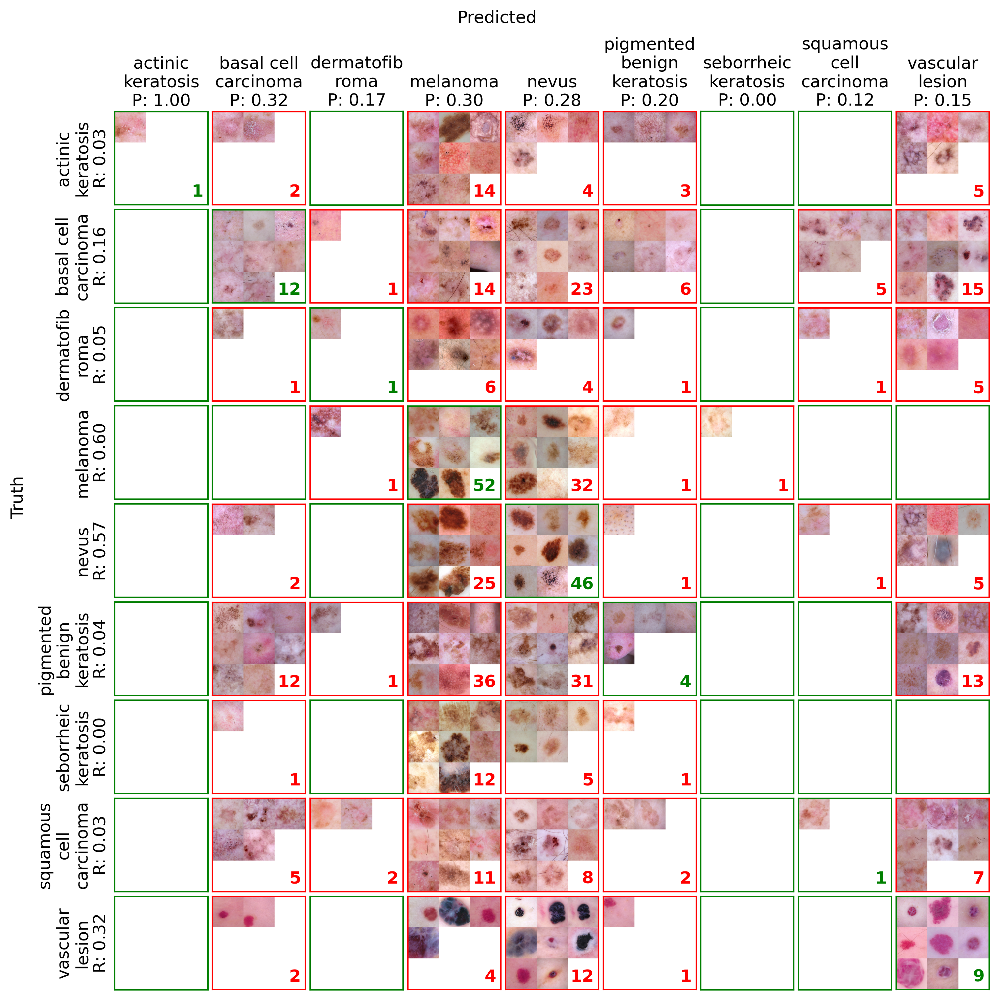

In [10]:
from dlfb.cancer.inspect import plot_classified_images
from dlfb.cancer.train import get_predictions

predictions = get_predictions(state, dataset_splits["valid"], resnet, 32)
plot_classified_images(
  predictions, dataset_splits["valid"], crop, max_images=8
);

### 6.1.4. Training the ResNetFromScratch Model


In [11]:
state, metrics = train(
  state=ResNetFromScratch(num_classes=num_classes).create_train_state(
    rng=rng_init,
    dummy_input=dataset_splits["train"].get_dummy_input(),
    tx=optax.adamw(learning_rate, weight_decay=0.0, mask=decay_mask),
  ),
  rng=rng_train,
  dataset_splits=dataset_splits,
  num_steps=num_steps,
  batch_size=32,
  preprocessor=crop,  # No preprocessing.
  sampler=repeating_sampler,  # No balancing.
  augmentor=None,  # No augmentation.
  eval_every=100,
  store_path=assets("cancer/models/resnet_from_scratch"),
)

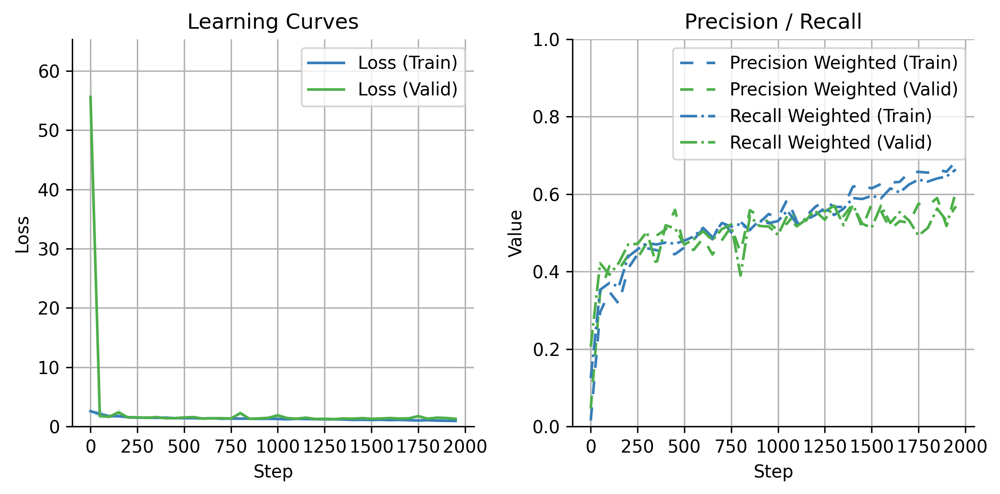

In [12]:
plot_learning(metrics);

/content/drive/MyDrive/dlfb/src/dlfb/cancer/inspect.py:80: RuntimeWarning: invalid value encountered in divide
  precision = np.diag(cm) / np.sum(cm, axis=0)
2025-07-01 15:36:08.590 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.022503333166241646..1.000000238418579].


2025-07-01 15:36:08.594 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.001692080171778798..1.0000001192092896].


2025-07-01 15:36:08.618 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.00348933064378798..1.000000238418579].


2025-07-01 15:36:08.629 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.00023707267246209085..1.000000238418579].


2025-07-01 15:36:08.647 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.003145522903650999..1.0000001192092896].


2025-07-01 15:36:08.656 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.05104007571935654..1.000000238418579].


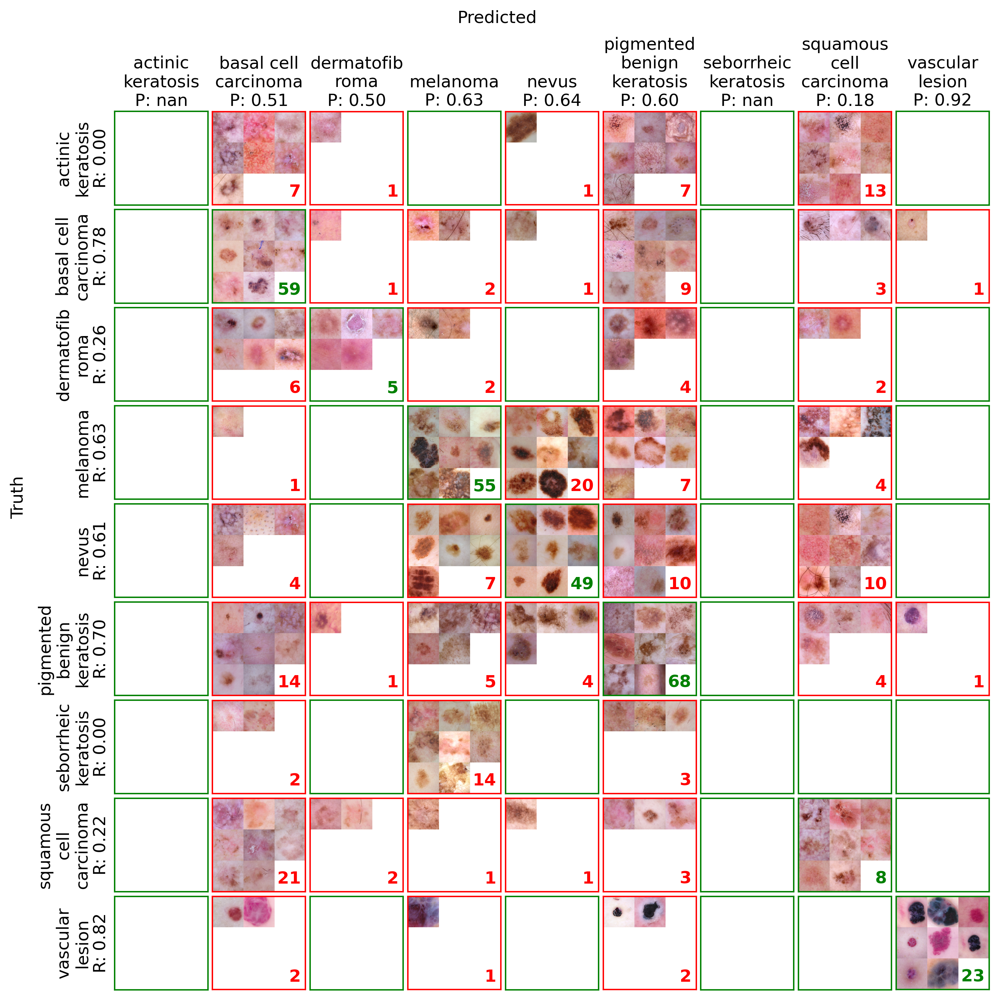

In [13]:
predictions = get_predictions(state, dataset_splits["valid"], resnet, 32)
plot_classified_images(
  predictions, dataset_splits["valid"], crop, max_images=8
);

### 6.1.5. Training the FinetunedHeadResNet Model


In [14]:
from dlfb.cancer.dataset.preprocessors import resnet

display(
  [
    'IMAGE_PROCESSOR = AutoImageProcessor.from_pretrained("microsoft/resnet-50")',
    resnet
  ]
)

IMAGE_PROCESSOR = AutoImageProcessor.from_pretrained("microsoft/resnet-50")

def resnet(image: jax.Array) -> jax.Array:
  """Preprocess from pretrained model with transpose for compatibility."""
  image = IMAGE_PROCESSOR(image, return_tensors="jax", do_rescale=True)
  image = image["pixel_values"]
  image = convert_nchw_to_nhwc(image)
  return image

In [15]:
state, metrics = train(
  state=FinetunedHeadResNet(num_classes=num_classes).create_train_state(
    rng=rng_init,
    dummy_input=dataset_splits["train"].get_dummy_input(),
    tx=optax.adamw(learning_rate, weight_decay=0.0, mask=decay_mask),
  ),
  rng=rng_train,
  dataset_splits=dataset_splits,
  num_steps=num_steps,
  batch_size=32,
  preprocessor=resnet,
  sampler=repeating_sampler,
  augmentor=None,
  eval_every=100,
  store_path=assets("cancer/models/resnet_just_head"),
)

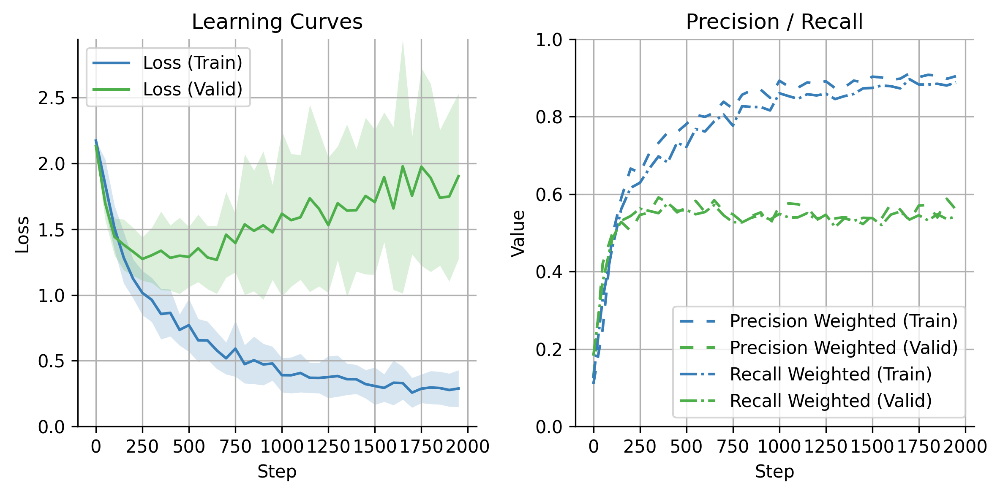

In [16]:
plot_learning(metrics);

### 6.1.6. Training the `FinetunedResNet` Model


In [17]:
state, metrics = train(
  state=FinetunedResNet(num_classes=num_classes).create_train_state(
    rng=rng_init,
    dummy_input=dataset_splits["train"].get_dummy_input(),
    tx=optax.adamw(learning_rate, weight_decay=0.0, mask=decay_mask),
  ),
  rng=rng_train,
  dataset_splits=dataset_splits,
  num_steps=num_steps,
  batch_size=32,
  preprocessor=resnet,
  sampler=repeating_sampler,
  augmentor=None,
  eval_every=100,
  store_path=assets("cancer/models/resnet50_basic"),
)

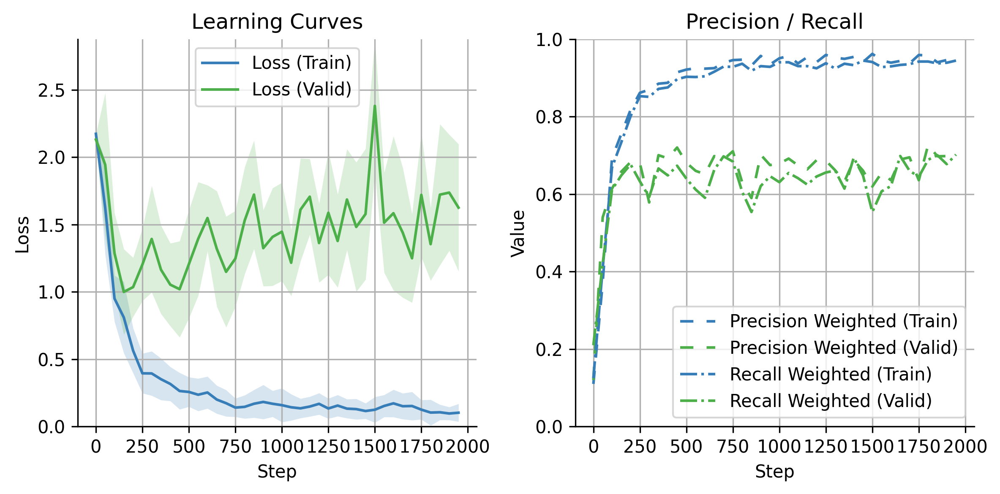

In [18]:
plot_learning(metrics);

### 6.1.7. Optimizing the `FinetunedResNet` Model
#### 6.1.7.1. Learning Rate Schedule


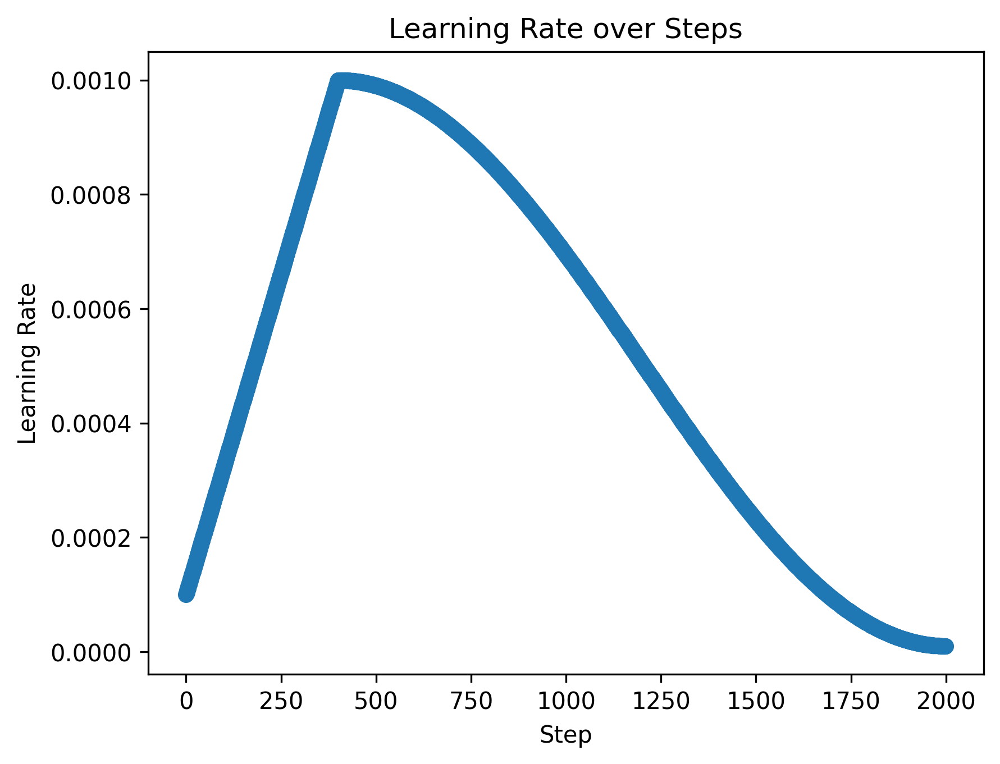

In [19]:
import optax

learning_rate = 0.001
num_steps = 2000

warmup_cosine_decay_scheduler = optax.warmup_cosine_decay_schedule(
  init_value=0.0001,
  peak_value=learning_rate,
  end_value=0.00001,
  warmup_steps=int(num_steps * 0.2),
  decay_steps=num_steps,
)

lrs = [warmup_cosine_decay_scheduler(i) for i in range(num_steps)]

plt.scatter(range(num_steps), lrs)
plt.title("Learning Rate over Steps")
plt.ylabel("Learning Rate")
plt.xlabel("Step");

#### 6.1.7.2. Data Augmentation
#### 6.1.7.3. Regularization via Dropout and `adamw`
### 6.1.8. Training the Optimized `FinetunedResNet` Model


In [20]:
state, metrics = train(
  state=FinetunedResNet(
    num_classes=num_classes, dropout_rate=0.7
  ).create_train_state(
    rng=rng_init,
    dummy_input=dataset_splits["train"].get_dummy_input(),
    tx=optax.adamw(
      warmup_cosine_decay_scheduler, weight_decay=1e-4, mask=decay_mask
    ),
  ),
  rng=rng_train,
  dataset_splits=dataset_splits,
  num_steps=num_steps,
  batch_size=32,
  preprocessor=resnet,
  sampler=repeating_sampler,
  augmentor=rich_augmentor,
  eval_every=100,
  store_path=assets("cancer/models/resnet50_optimized"),
)

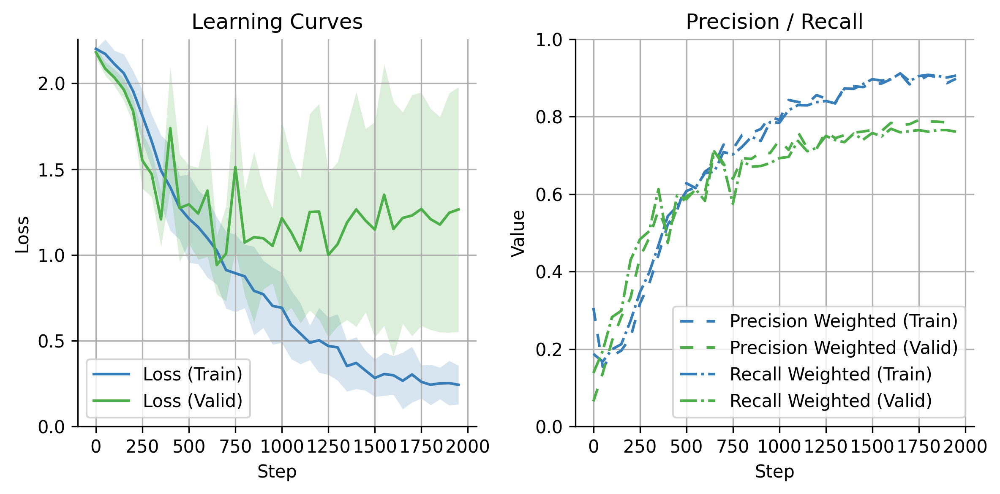

In [21]:
plot_learning(metrics);

/content/drive/MyDrive/dlfb/src/dlfb/cancer/inspect.py:80: RuntimeWarning: invalid value encountered in divide
  precision = np.diag(cm) / np.sum(cm, axis=0)


2025-07-01 15:36:19.147 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.000000238418579].


2025-07-01 15:36:19.151 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.003145522903650999..1.0000001192092896].


2025-07-01 15:36:19.156 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.00023707267246209085..1.000000238418579].


2025-07-01 15:36:19.165 WARNING matplotlib.image image - _normalize_image_array: Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.06661460548639297..1.000000238418579].


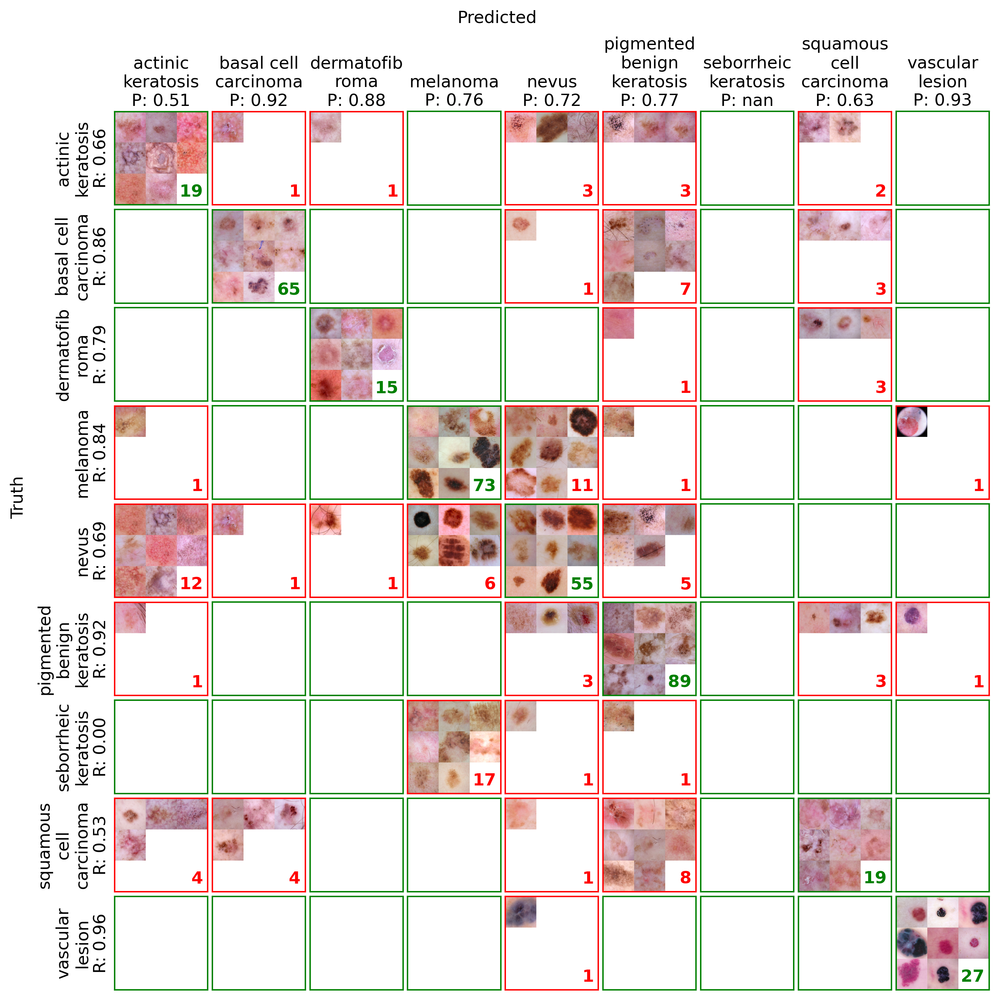

In [22]:
predictions = get_predictions(state, dataset_splits["valid"], resnet, 32)
plot_classified_images(
  predictions, dataset_splits["valid"], crop, max_images=8
);

### 6.1.9. Further Improving the Model


## 6.2. Summary
